Calculate the Bayes factor for SFR to determine whether the Kirshner87 and SDSS DR7 samples are drawn from the same or different parent distributions.

In [1]:
from astropy.table import Table
from astropy.io import fits

import numpy as np

import sys

import pickle

import pocomc as pc

import matplotlib
import matplotlib.pyplot as plt

from functions import Model_1_plot, Model_2_plot

np.set_printoptions(threshold=sys.maxsize)

In [2]:
matplotlib.rc('font', size=14)
matplotlib.rc('font', family='DejaVu Sans')

# Data

In [3]:
#data_directory = '../../../../data/'
data_directory = '../../../../Data/'
SDSS_filename = data_directory + 'NSA/NSA_v1_0_1_VAGC_vflag-V2-VF.fits'
Kirshner_filename = data_directory + 'KNSA.txt'

hdu = fits.open(SDSS_filename)
SDSS = Table(hdu[1].data)
hdu.close()

Kirshner = Table.read(Kirshner_filename, format='ascii.commented_header')

## Just keep the main SDSS DR7 footprint

In [4]:
catalog_SDSS = SDSS[SDSS['IN_DR7_LSS'] == 1]
del SDSS

ra_boolean = np.logical_and(catalog_SDSS['RA'] > 110, catalog_SDSS['RA'] < 270)
catalog_north = catalog_SDSS[ra_boolean]
del catalog_SDSS

strip_boolean = np.logical_and.reduce([catalog_north['RA'] > 250, 
                                       catalog_north['RA'] < 269, 
                                       catalog_north['DEC'] > 51, 
                                       catalog_north['DEC'] < 67])
catalog_main = catalog_north[~strip_boolean]
del catalog_north

In [5]:
SFR_SDSS = catalog_main['SFR']
SFR_Kirshner = Kirshner['SFR']

In [6]:
del catalog_main, Kirshner

# Fit the SFR distributions with skewnormal distributions

Both one- and two-parent models

This is a bimodal distribution.

In [7]:
SDSS_bins = np.arange(-2.5, 1.5, 0.1)
Kirshner_bins = np.arange(-2.5, 1.5, 0.2)

In [8]:
labels1_bi = ['s', 'a', r'$\mu_a$', r'$\sigma_a$', 'skew$_a$', 
                   'b', r'$\mu_b$', r'$\sigma_b$', 'skew$_b$']
labels2_bi = ['$a_1$', r'$\mu_{1a}$', r'$\sigma_{1a}$', 'skew$_{1a}$', 
              '$b_1$', r'$\mu_{1b}$', r'$\sigma_{1b}$', 'skew$_{1b}$', 
              '$a_2$', r'$\mu_{2a}$', r'$\sigma_{2a}$', 'skew$_{2a}$', 
              '$b_2$', r'$\mu_{2b}$', r'$\sigma_{2b}$', 'skew$_{2b}$']

labels1_tri = ['s', 'a', r'$\mu_a$', r'$\sigma_a$', 'skew$_a$', 
                    'b', r'$\mu_b$', r'$\sigma_b$', 'skew$_b$', 
                    'c', r'$\mu_c$', r'$\sigma_c$', 'skew$_c$']
labels2_tri = ['$a_1$', r'$\mu_{1a}$', r'$\sigma_{1a}$', 'skew$_{1a}$', 
               '$b_1$', r'$\mu_{1b}$', r'$\sigma_{1b}$', 'skew$_{1b}$', 
               '$c_2$', r'$\mu_{1c}$', r'$\sigma_{1c}$', 'skew$_{1c}$', 
               '$a_2$', r'$\mu_{2a}$', r'$\sigma_{2a}$', 'skew$_{2a}$', 
               '$b_2$', r'$\mu_{2b}$', r'$\sigma_{2b}$', 'skew$_{2b}$', 
               '$c_2$', r'$\mu_{2c}$', r'$\sigma_{2c}$', 'skew$_{2c}$']

## 1-parent model

In [18]:
temp_infile = open('pocoMC_results/sampler_results_SFR_M1.pickle', 'rb')
results1 = pickle.load(temp_infile)
temp_infile.close()

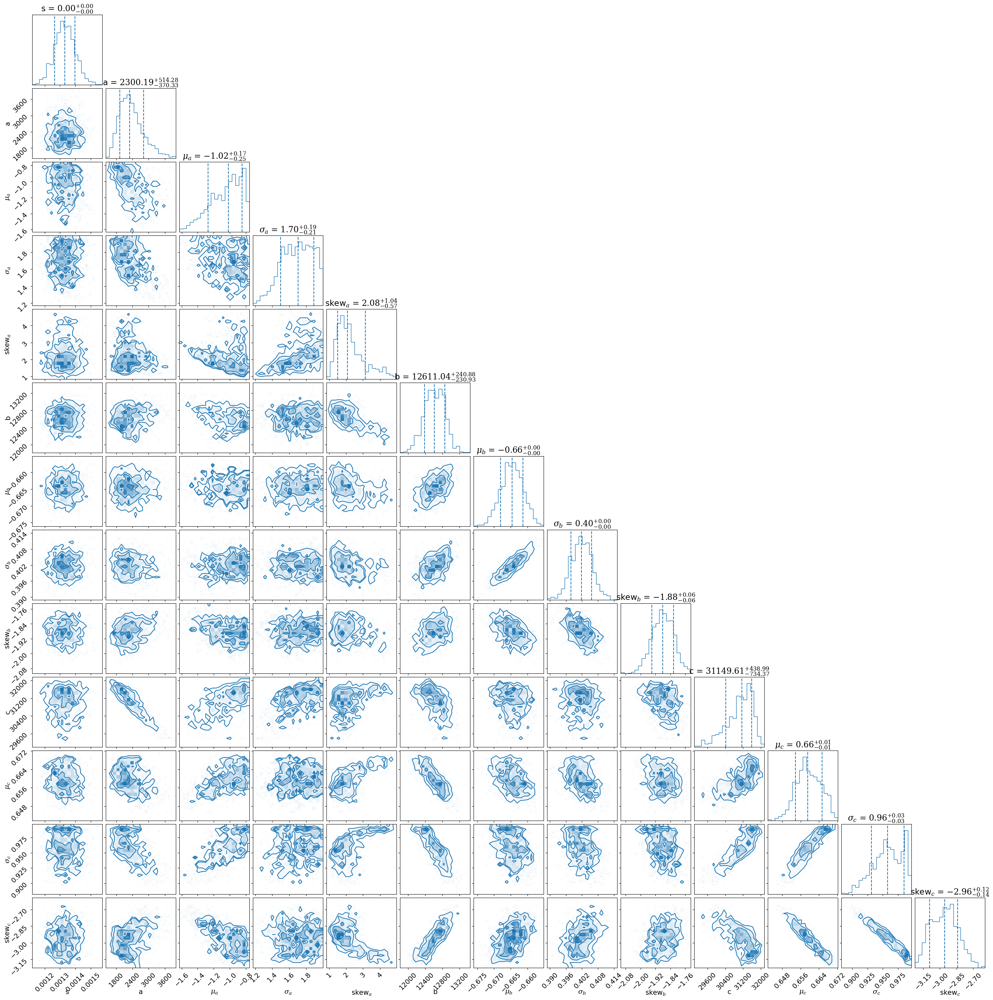

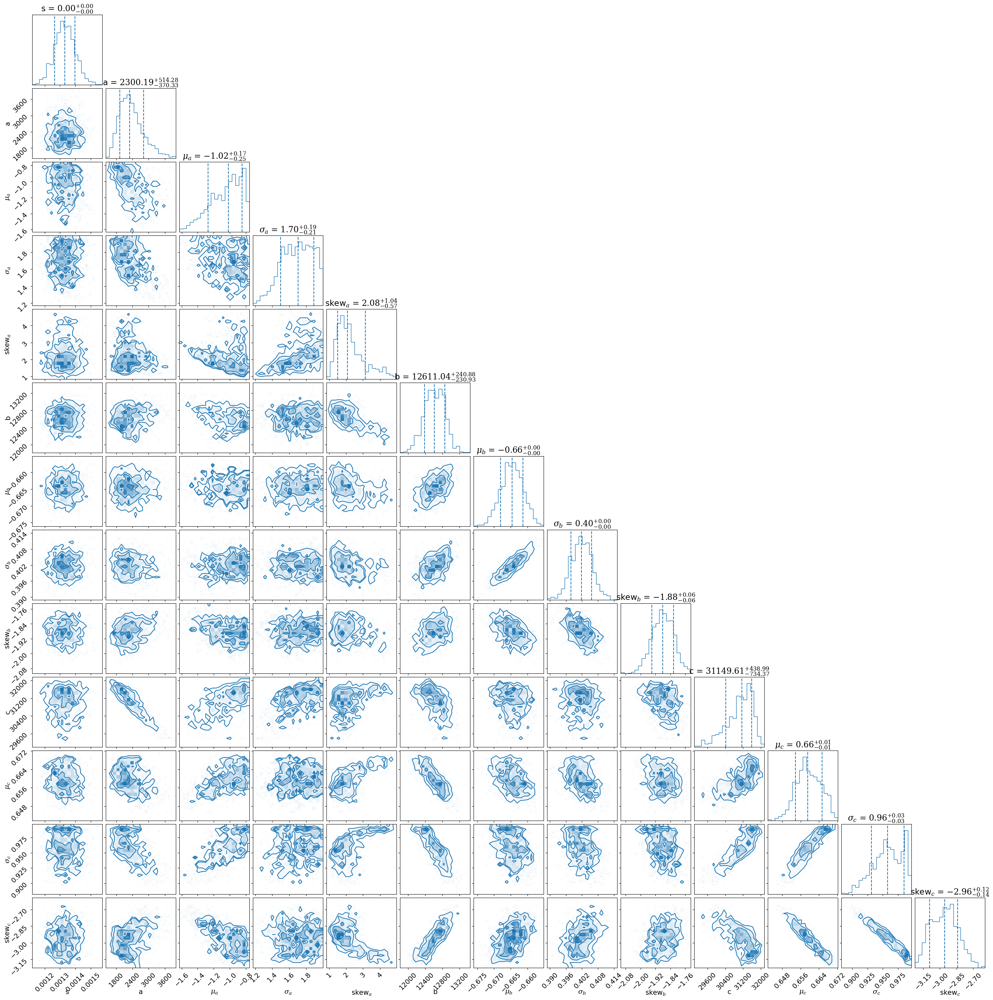

In [19]:
pc.plotting.corner(results1, 
                   labels=labels1_tri, 
                   dims=range(len(labels1_tri)), 
                   show_titles=True, 
                   quantiles=[0.16, 0.5, 0.84])

In [20]:
lnzM1 = results1['logz'][-1]
lnzM1

-369.1590196702416

In [21]:
bestfit1 = np.mean(results1['samples'], axis=0)
bestfit1

array([ 1.3314190e-03,  2.3677009e+03, -1.0527536e+00,  1.6882925e+00,
        2.2888710e+00,  1.2612165e+04, -6.6466665e-01,  4.0178463e-01,
       -1.8813339e+00,  3.1035727e+04,  6.5941542e-01,  9.5713544e-01,
       -2.9590478e+00], dtype=float32)

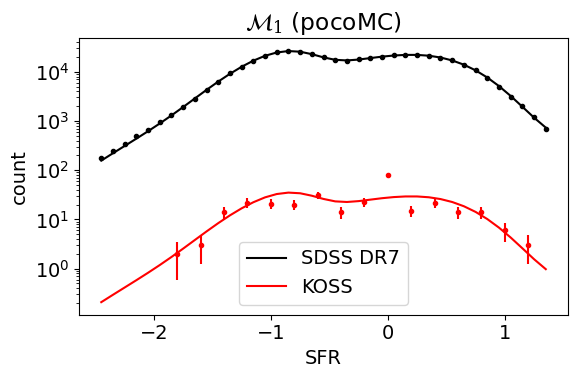

In [22]:
Model_1_plot(bestfit1, 
             SFR_SDSS, 
             SFR_Kirshner, 
             SDSS_bins, 
             Kirshner_bins, 
             3, 
             xlabel_text='SFR', 
             title_text=r'$\mathcal{M}_1$ (pocoMC)')

## 2-parent model

In [29]:
temp_infile = open('pocoMC_results/sampler_results_SFR_M2.pickle', 'rb')
results2 = pickle.load(temp_infile)
temp_infile.close()

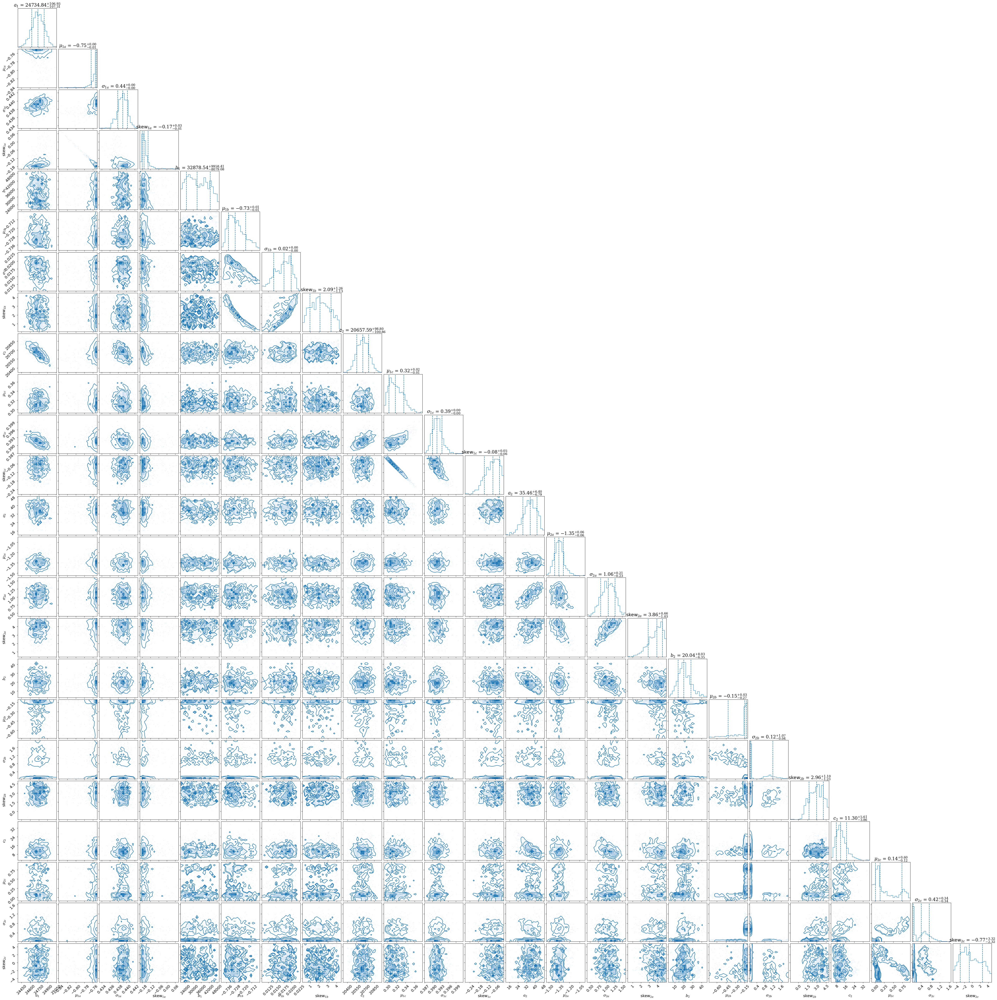

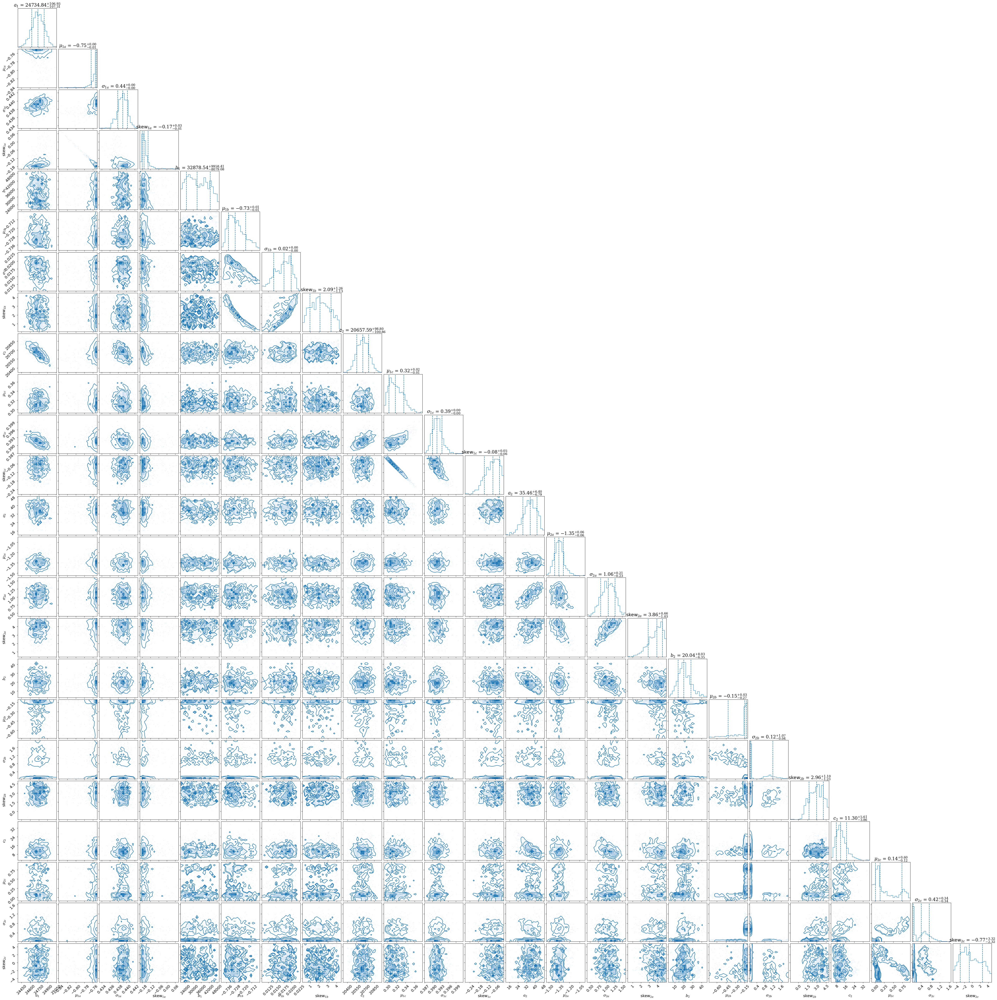

In [30]:
pc.plotting.corner(results2, 
                   labels=labels2_tri, 
                   dims=range(len(labels2_tri)), 
                   show_titles=True, 
                   quantiles=[0.16, 0.5, 0.84])

In [31]:
lnzM2 = results2['logz'][-1]
lnzM2

-2490.927290700584

In [32]:
bestfit2 = np.mean(results2['samples'], axis=0)
bestfit2

array([ 2.4734811e+04, -7.5859171e-01,  4.3900660e-01, -1.5505074e-01,
        3.3559531e+04, -7.2627372e-01,  1.7148299e-02,  2.1478765e+00,
        2.0657342e+04,  3.1962588e-01,  3.9185157e-01, -8.4204420e-02,
        3.5087864e+01, -1.3492430e+00,  1.0557630e+00,  3.6996493e+00,
        2.0804607e+01, -2.3381528e-01,  5.3206640e-01,  2.8982565e+00,
        1.2157693e+01,  2.8858668e-01,  4.0901011e-01, -4.2246976e-01],
      dtype=float32)

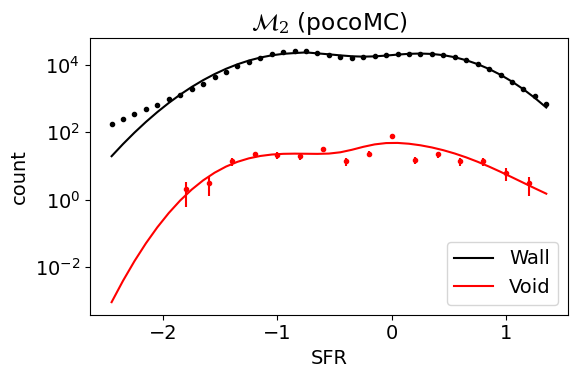

In [33]:
Model_2_plot(bestfit2, 
             SFR_SDSS, 
             SFR_Kirshner, 
             SDSS_bins, 
             Kirshner_bins, 
             [3, 3], 
             xlabel_text='SFR', 
             title_text=r'$\mathcal{M}_2$ (pocoMC)')

# Calculate Bayes factor

In [34]:
lnB12 = lnzM1 - lnzM2

B12 = np.exp(lnB12)

print('SFR: B12 = {:.3g}; log(B12) = {:.3f}'.format(B12, lnB12*np.log10(np.exp(1))))

SFR: B12 = inf; log(B12) = 921.472


/opt/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: overflow encountered in exp
  This is separate from the ipykernel package so we can avoid doing imports until
